In [74]:
import pandas as pd
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

In [75]:
# Load and preprocess the data
data = pd.read_csv('./data/fashion.csv') 
image_paths = data.apply(lambda row: f"./data/{row['Category']}/{row['Gender']}/Images/images_with_product_ids/{row['Image']}", axis=1).tolist()
labels = data['Colour']

In [76]:
image_width, image_height = 180, 240

In [77]:
# Load and preprocess the images
X = []
for image_path in image_paths:
    image = load_img(image_path)
    image = smart_resize(image, (image_width, image_height))
    image = img_to_array(image) / 255.0
    X.append(image)
X = np.array(X)


In [78]:
# Encode the color labels
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(labels)
num_classes = len(label_encoder.classes_)

In [79]:
# Split the dataset into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [80]:
# Create the neural network model
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(image_width, image_height, 3)))
model.add(MaxPooling2D((2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2, 2)))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))


In [81]:
# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


In [82]:
# Train the model
model.fit(X_train, y_train, batch_size=32, epochs=10, validation_split=0.2)



Epoch 1/10
59/59 [==============================] - 82s 1s/step - loss: 2.9312 - accuracy: 0.3916 - val_loss: 1.6736 - val_accuracy: 0.5634
Epoch 2/10
59/59 [==============================] - 83s 1s/step - loss: 1.4051 - accuracy: 0.6353 - val_loss: 1.3600 - val_accuracy: 0.6000
Epoch 3/10
59/59 [==============================] - 87s 1s/step - loss: 0.8991 - accuracy: 0.7472 - val_loss: 1.4384 - val_accuracy: 0.6301
Epoch 4/10
59/59 [==============================] - 91s 2s/step - loss: 0.4889 - accuracy: 0.8704 - val_loss: 1.4113 - val_accuracy: 0.6452
Epoch 5/10
59/59 [==============================] - 86s 1s/step - loss: 0.2172 - accuracy: 0.9441 - val_loss: 1.8268 - val_accuracy: 0.6387
Epoch 6/10
59/59 [==============================] - 85s 1s/step - loss: 0.1275 - accuracy: 0.9661 - val_loss: 2.0192 - val_accuracy: 0.5892
Epoch 7/10
59/59 [==============================] - 84s 1s/step - loss: 0.3092 - accuracy: 0.9242 - val_loss: 2.0363 - val_accuracy: 0.6430
Epoch 8/10
59/59 [==

In [83]:
# Evaluate the model
loss, accuracy = model.evaluate(X_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

19/19 [==============================] - 6s 297ms/step - loss: 1.9941 - accuracy: 0.6615
Test Loss: 1.9941003322601318
Test Accuracy: 0.661512017250061


In [84]:
# Make predictions
predictions = model.predict(X_test)
predicted_colors = label_encoder.inverse_transform(np.argmax(predictions, axis=1))


19/19 [==============================] - 5s 277ms/step


## Testing it on another dataset

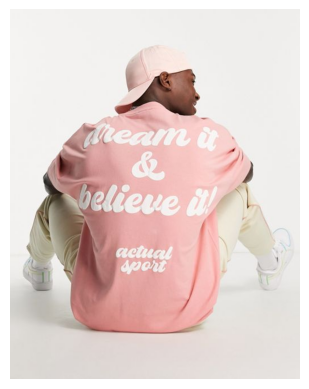

1/1 [==============================] - 0s 43ms/step
Predicted Color: Pink
Color Probability: 0.84983885
--------------------


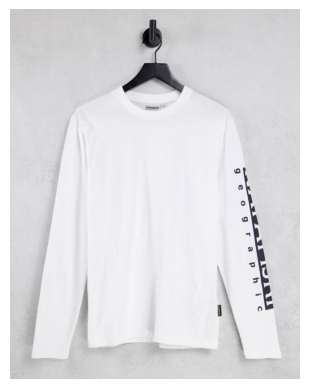

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.60835046
--------------------


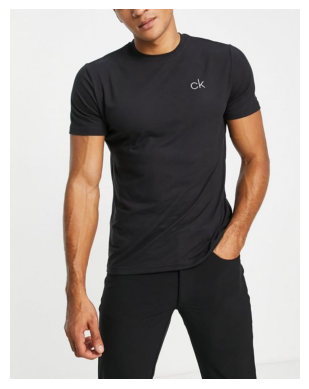

1/1 [==============================] - 0s 41ms/step
Predicted Color: Black
Color Probability: 0.9845068
--------------------


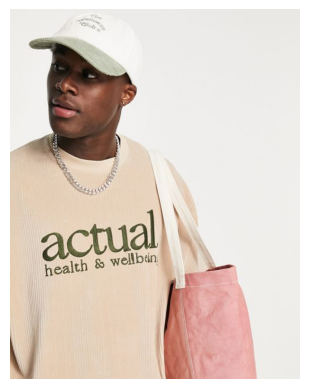

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.97754717
--------------------


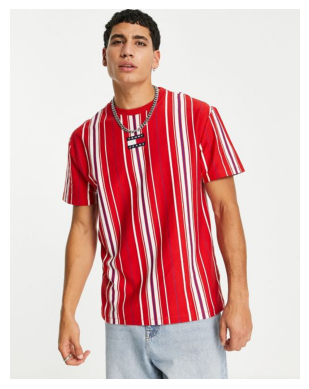

1/1 [==============================] - 0s 46ms/step
Predicted Color: Red
Color Probability: 1.0
--------------------


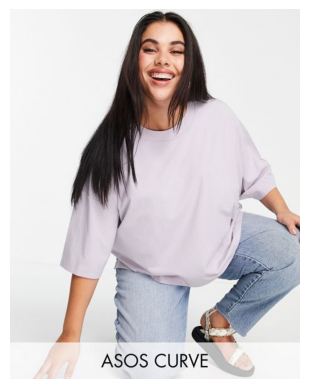

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.9471251
--------------------


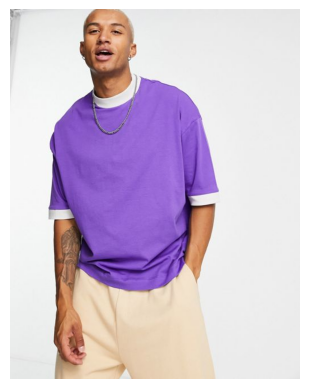

1/1 [==============================] - 0s 42ms/step
Predicted Color: Blue
Color Probability: 0.6234228
--------------------


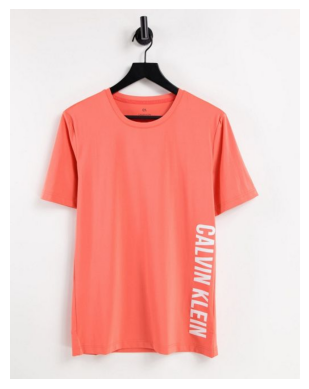

1/1 [==============================] - 0s 39ms/step
Predicted Color: Pink
Color Probability: 0.95527405
--------------------


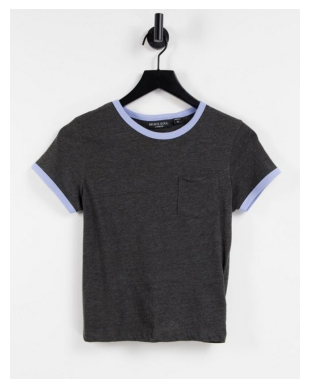

1/1 [==============================] - 0s 53ms/step
Predicted Color: Navy Blue
Color Probability: 0.86006624
--------------------


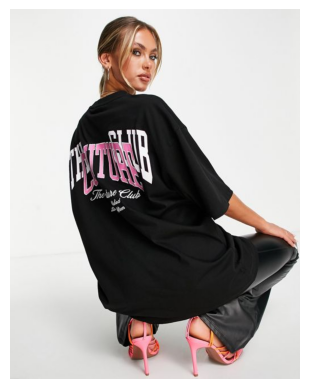

1/1 [==============================] - 0s 54ms/step
Predicted Color: Black
Color Probability: 0.9999987
--------------------


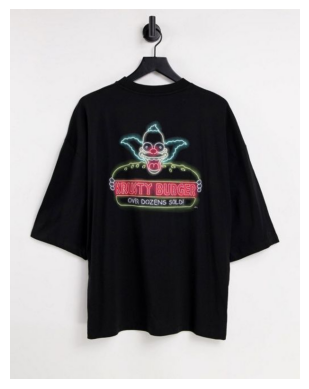

1/1 [==============================] - 0s 62ms/step
Predicted Color: Black
Color Probability: 0.99985075
--------------------


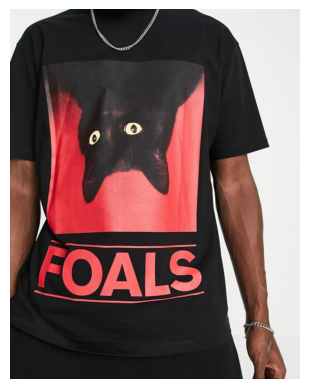

1/1 [==============================] - 0s 38ms/step
Predicted Color: Pink
Color Probability: 0.61247677
--------------------


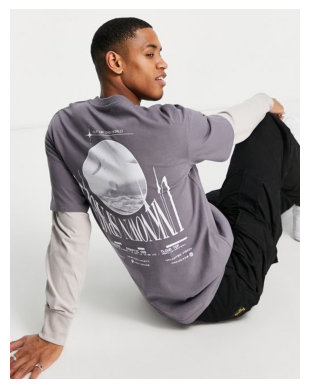

1/1 [==============================] - 0s 48ms/step
Predicted Color: Black
Color Probability: 0.9989681
--------------------


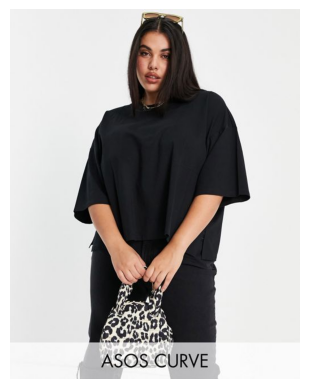

1/1 [==============================] - 0s 40ms/step
Top Three Colors:
Color: Yellow, Probability: 0.41168710589408875
Color: Black, Probability: 0.258456289768219
Color: Navy Blue, Probability: 0.1770358830690384
--------------------


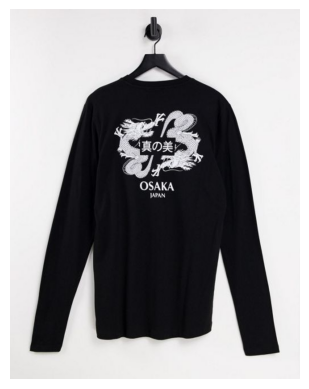

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.94141674
--------------------


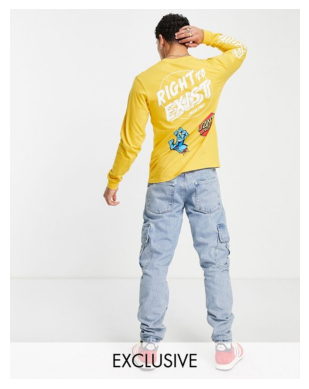

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Yellow, Probability: 0.46699318289756775
Color: Beige, Probability: 0.19176074862480164
Color: White, Probability: 0.17396913468837738
--------------------


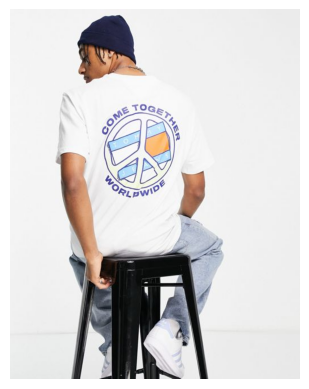

1/1 [==============================] - 0s 41ms/step
Predicted Color: White
Color Probability: 0.64875406
--------------------


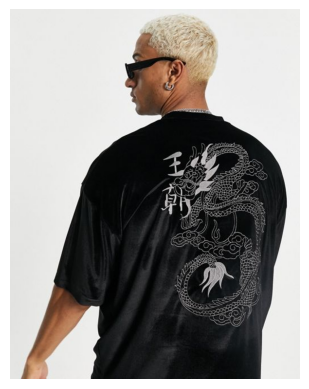

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.9931375
--------------------


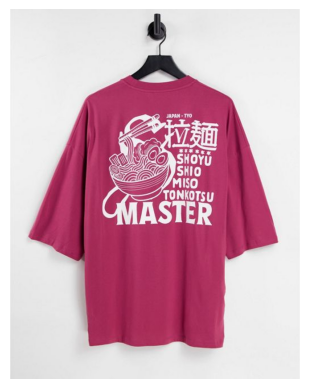

1/1 [==============================] - 0s 39ms/step
Predicted Color: Pink
Color Probability: 0.9489371
--------------------


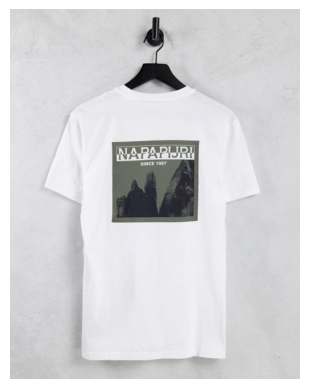

1/1 [==============================] - 0s 46ms/step
Top Three Colors:
Color: Pink, Probability: 0.3269043564796448
Color: Blue, Probability: 0.2835296094417572
Color: Grey, Probability: 0.16966183483600616
--------------------


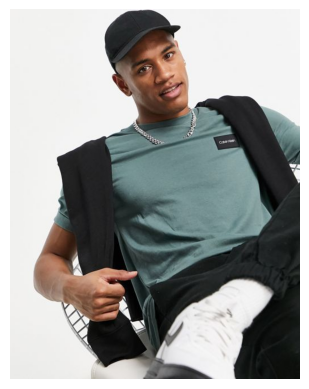

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.9996357
--------------------


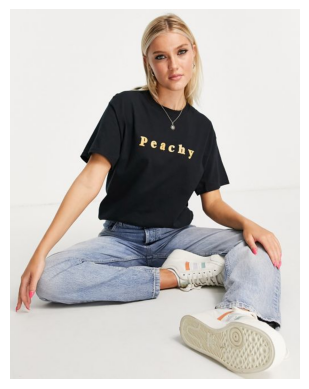

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.9412913
--------------------


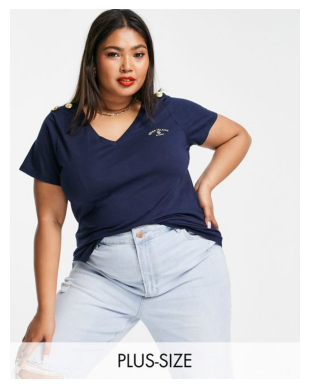

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.9733421
--------------------


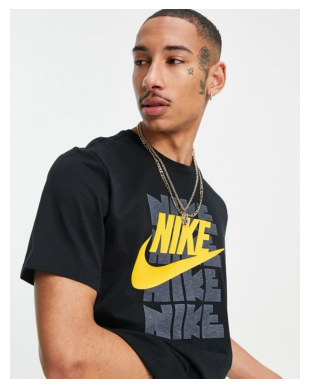

1/1 [==============================] - 0s 48ms/step
Predicted Color: Black
Color Probability: 0.79401577
--------------------


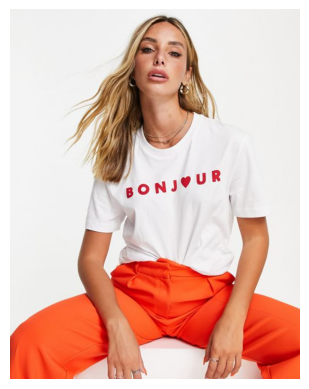

1/1 [==============================] - 0s 55ms/step
Predicted Color: Orange
Color Probability: 0.6951991
--------------------


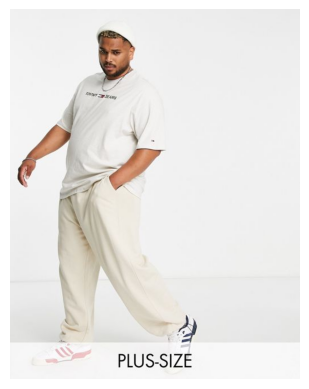

1/1 [==============================] - 0s 50ms/step
Predicted Color: White
Color Probability: 0.824911
--------------------


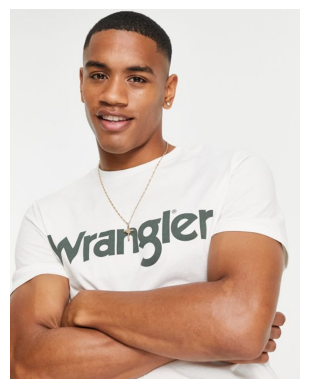

1/1 [==============================] - 0s 44ms/step
Top Three Colors:
Color: Pink, Probability: 0.5552001595497131
Color: Yellow, Probability: 0.1615682989358902
Color: Black, Probability: 0.07998500764369965
--------------------


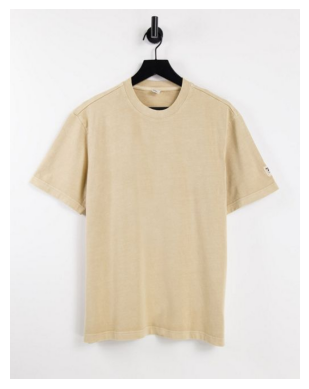

1/1 [==============================] - 0s 42ms/step
Predicted Color: Yellow
Color Probability: 0.992991
--------------------


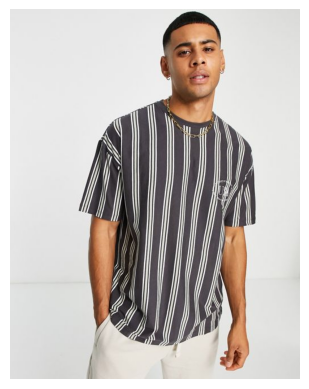

1/1 [==============================] - 0s 39ms/step
Predicted Color: Navy Blue
Color Probability: 0.85218275
--------------------


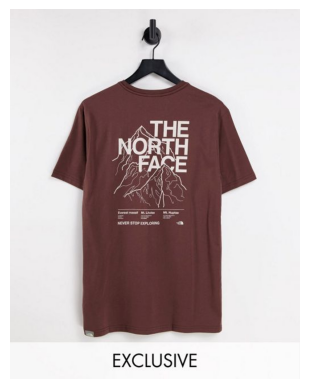

1/1 [==============================] - 0s 47ms/step
Predicted Color: Red
Color Probability: 0.66256523
--------------------


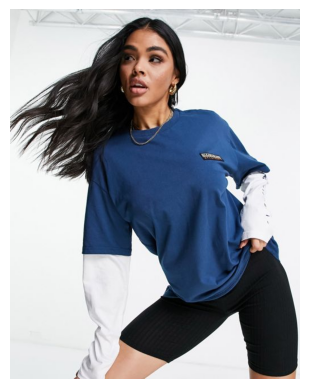

1/1 [==============================] - 0s 39ms/step
Predicted Color: Blue
Color Probability: 0.99719244
--------------------


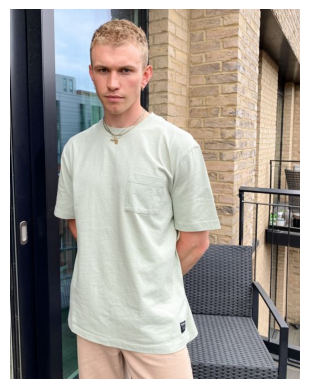

1/1 [==============================] - 0s 49ms/step
Predicted Color: White
Color Probability: 0.9998715
--------------------


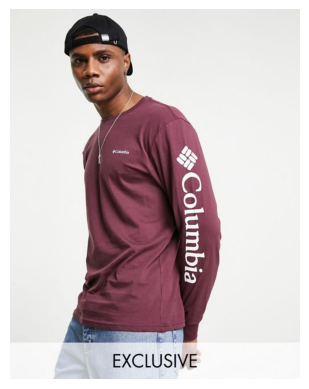

1/1 [==============================] - 0s 38ms/step
Predicted Color: Pink
Color Probability: 0.9605823
--------------------


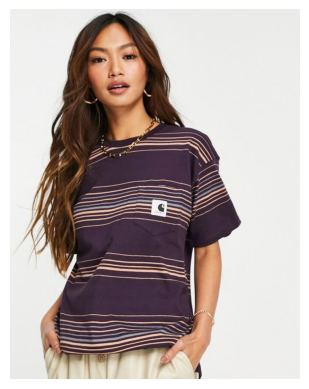

1/1 [==============================] - 0s 39ms/step
Predicted Color: Brown
Color Probability: 0.9108862
--------------------


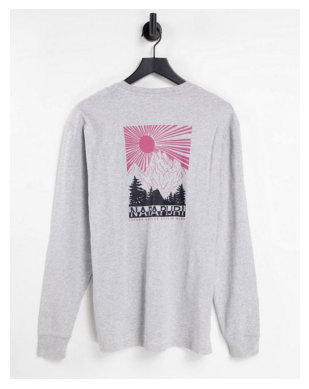

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.78366524
--------------------


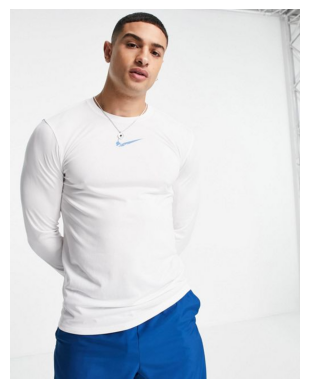

1/1 [==============================] - 0s 49ms/step
Predicted Color: White
Color Probability: 0.6374758
--------------------


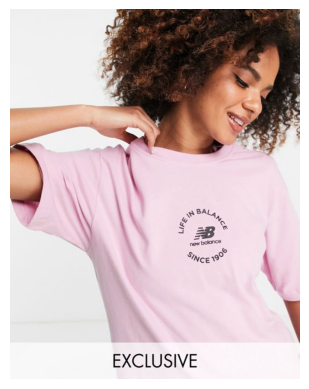

1/1 [==============================] - 0s 47ms/step
Predicted Color: White
Color Probability: 0.99984205
--------------------


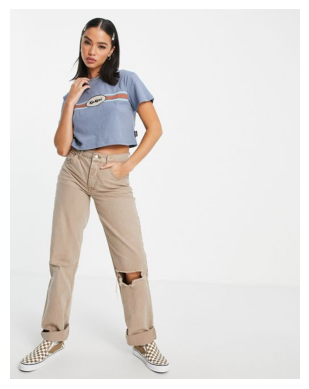

1/1 [==============================] - 0s 45ms/step
Top Three Colors:
Color: White, Probability: 0.5276917815208435
Color: Green, Probability: 0.14442574977874756
Color: Khaki, Probability: 0.10148677229881287
--------------------


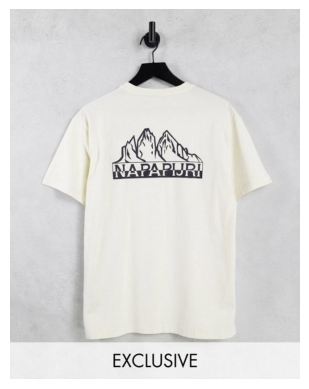

1/1 [==============================] - 0s 48ms/step
Predicted Color: White
Color Probability: 0.85443586
--------------------


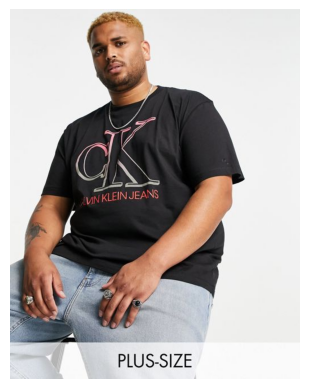

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Black, Probability: 0.5177516937255859
Color: Navy Blue, Probability: 0.4561619162559509
Color: White, Probability: 0.025558939203619957
--------------------


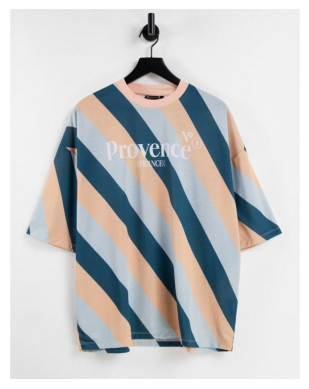

1/1 [==============================] - 0s 41ms/step
Top Three Colors:
Color: Yellow, Probability: 0.39923664927482605
Color: Black, Probability: 0.2566874325275421
Color: White, Probability: 0.1647922694683075
--------------------


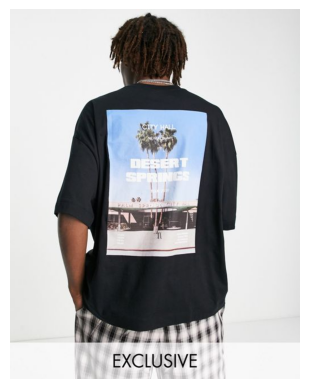

1/1 [==============================] - 0s 46ms/step
Predicted Color: White
Color Probability: 0.9203433
--------------------


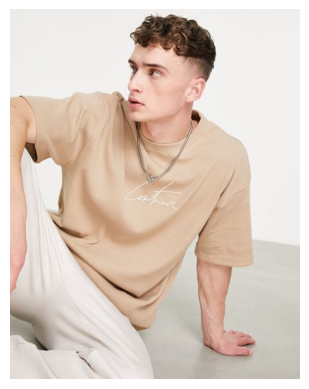

1/1 [==============================] - 0s 39ms/step
Predicted Color: Yellow
Color Probability: 0.99193597
--------------------


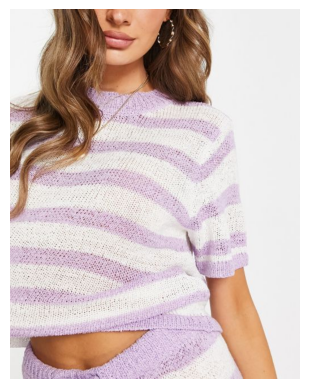

1/1 [==============================] - 0s 48ms/step
Predicted Color: White
Color Probability: 0.99878854
--------------------


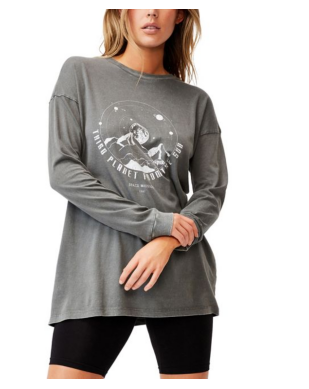

1/1 [==============================] - 0s 50ms/step
Predicted Color: Black
Color Probability: 0.627933
--------------------


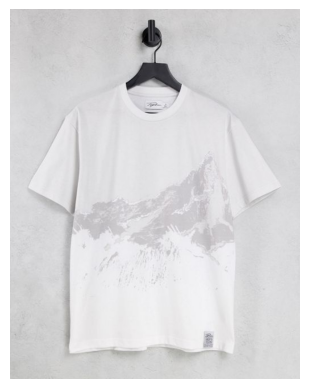

1/1 [==============================] - 0s 46ms/step
Predicted Color: White
Color Probability: 0.94965583
--------------------


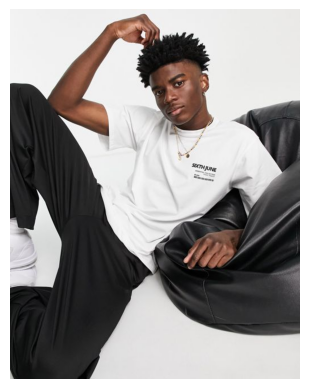

1/1 [==============================] - 0s 47ms/step
Predicted Color: White
Color Probability: 0.9996588
--------------------


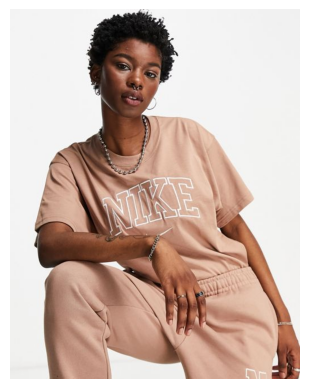

1/1 [==============================] - 0s 40ms/step
Top Three Colors:
Color: Pink, Probability: 0.5223071575164795
Color: Orange, Probability: 0.36574989557266235
Color: Brown, Probability: 0.10160624980926514
--------------------


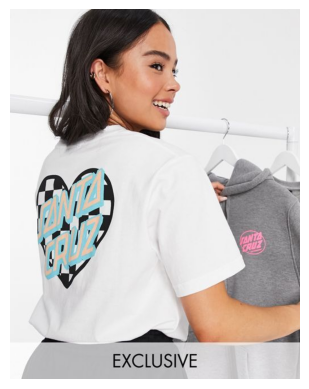

1/1 [==============================] - 0s 49ms/step
Predicted Color: White
Color Probability: 0.99518836
--------------------


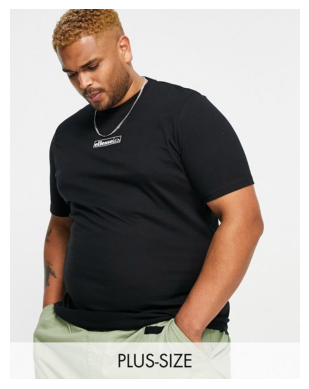

1/1 [==============================] - 0s 45ms/step
Predicted Color: Blue
Color Probability: 0.99957603
--------------------


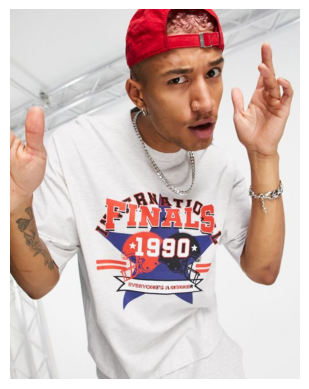

1/1 [==============================] - 0s 47ms/step
Predicted Color: White
Color Probability: 0.99129313
--------------------


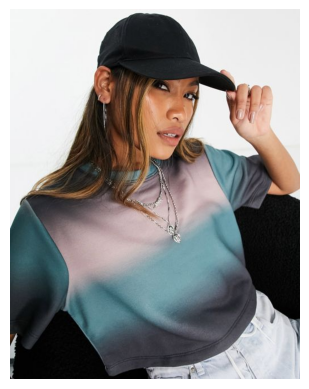

1/1 [==============================] - 0s 40ms/step
Predicted Color: White
Color Probability: 0.85054886
--------------------


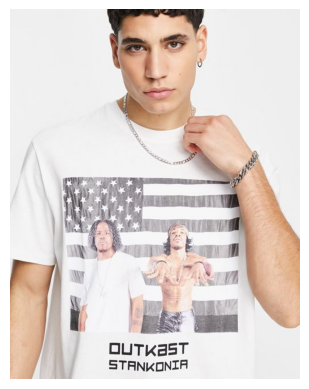

1/1 [==============================] - 0s 50ms/step
Predicted Color: White
Color Probability: 0.9992812
--------------------


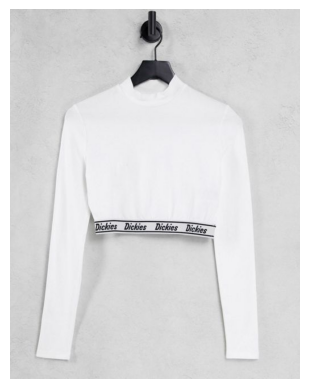

1/1 [==============================] - 0s 40ms/step
Predicted Color: White
Color Probability: 0.9900738
--------------------


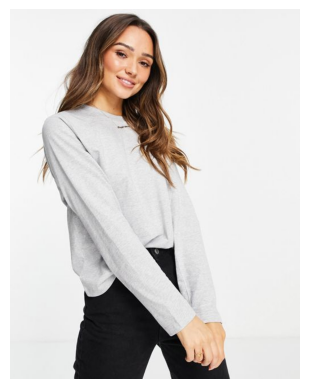

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.9978288
--------------------


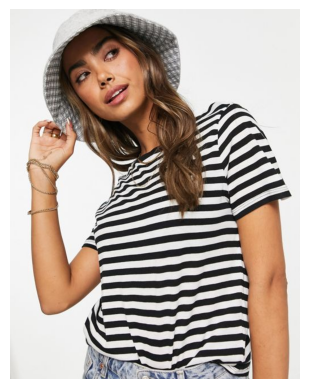

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.99415463
--------------------


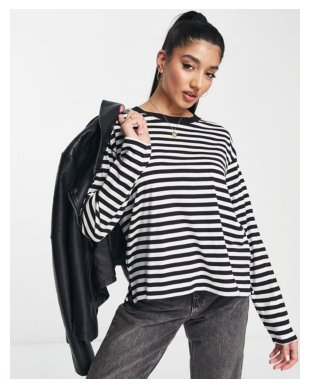

1/1 [==============================] - 0s 56ms/step
Predicted Color: Black
Color Probability: 0.98562104
--------------------


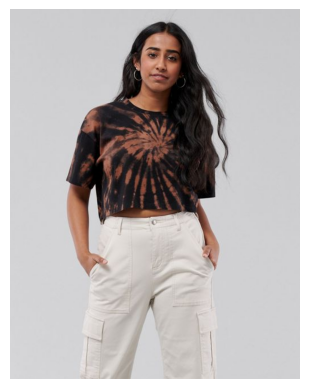

1/1 [==============================] - 0s 41ms/step
Predicted Color: Black
Color Probability: 0.765486
--------------------


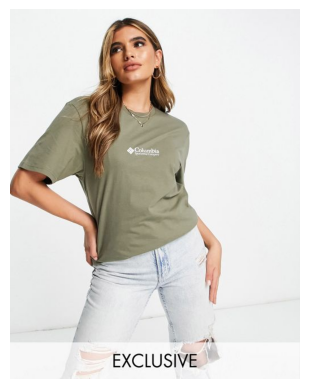

1/1 [==============================] - 0s 47ms/step
Top Three Colors:
Color: Olive, Probability: 0.46082350611686707
Color: Grey, Probability: 0.3705982565879822
Color: Pink, Probability: 0.06710287183523178
--------------------


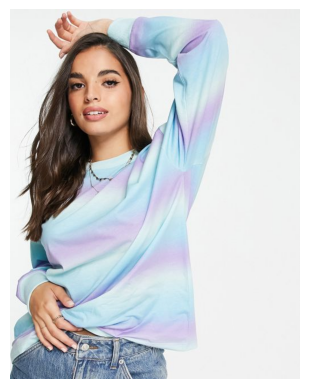

1/1 [==============================] - 0s 45ms/step
Predicted Color: White
Color Probability: 0.91140074
--------------------


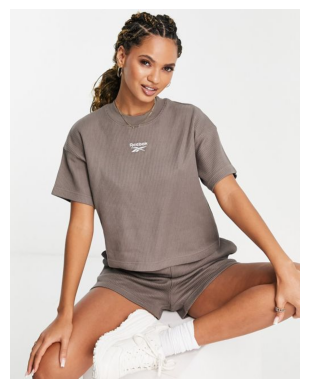

1/1 [==============================] - 0s 40ms/step
Predicted Color: Brown
Color Probability: 0.77489936
--------------------


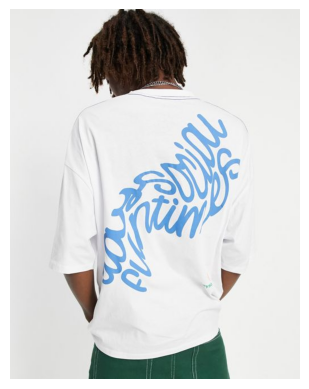

1/1 [==============================] - 0s 50ms/step
Predicted Color: Blue
Color Probability: 0.99770254
--------------------


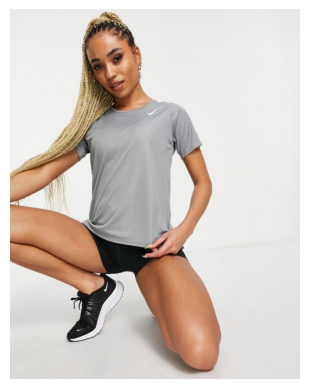

1/1 [==============================] - 0s 49ms/step
Predicted Color: Pink
Color Probability: 0.9628479
--------------------


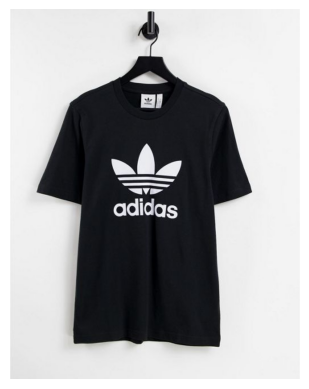

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.99208015
--------------------


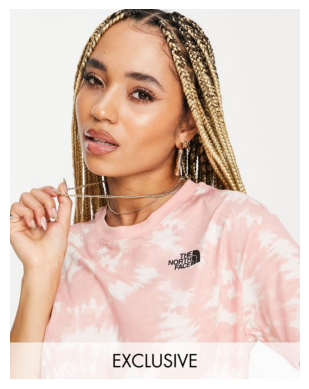

1/1 [==============================] - 0s 49ms/step
Predicted Color: Beige
Color Probability: 0.7664488
--------------------


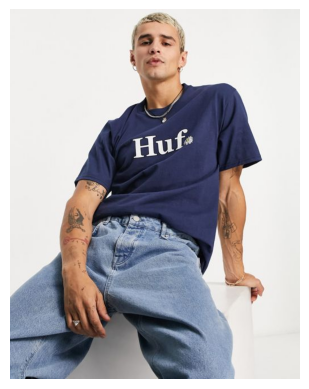

1/1 [==============================] - 0s 45ms/step
Predicted Color: Navy Blue
Color Probability: 0.84500706
--------------------


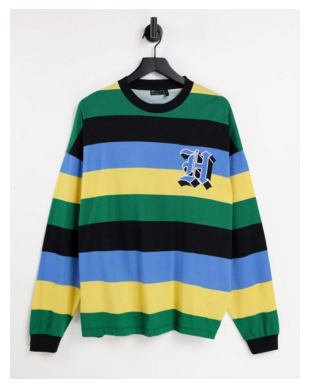

1/1 [==============================] - 0s 48ms/step
Predicted Color: Blue
Color Probability: 0.99934596
--------------------


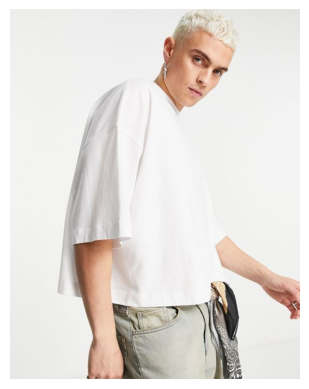

1/1 [==============================] - 0s 49ms/step
Predicted Color: Pink
Color Probability: 0.715829
--------------------


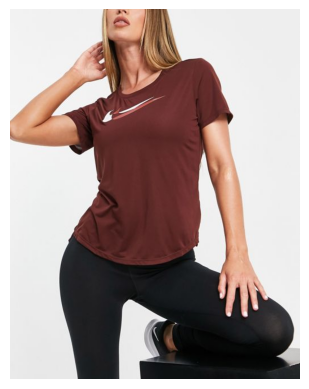

1/1 [==============================] - 0s 38ms/step
Predicted Color: Red
Color Probability: 0.88326734
--------------------


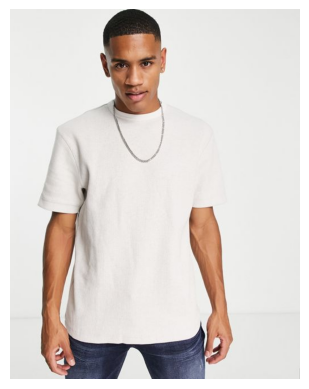

1/1 [==============================] - 0s 47ms/step
Predicted Color: White
Color Probability: 0.7280081
--------------------


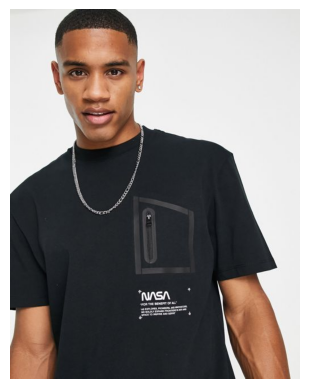

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.98874086
--------------------


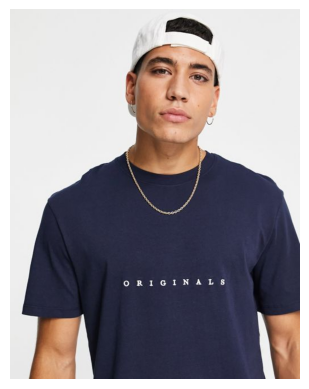

1/1 [==============================] - 0s 49ms/step
Predicted Color: Pink
Color Probability: 0.863774
--------------------


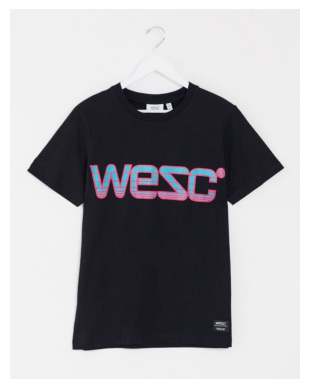

1/1 [==============================] - 0s 48ms/step
Predicted Color: Black
Color Probability: 0.9995871
--------------------


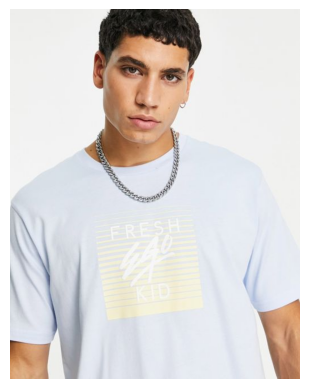

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Pink, Probability: 0.5004245638847351
Color: White, Probability: 0.47380736470222473
Color: Beige, Probability: 0.018579822033643723
--------------------


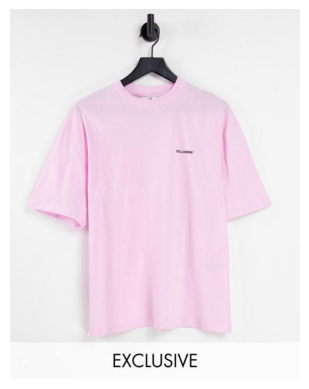

1/1 [==============================] - 0s 46ms/step
Predicted Color: Pink
Color Probability: 0.9081991
--------------------


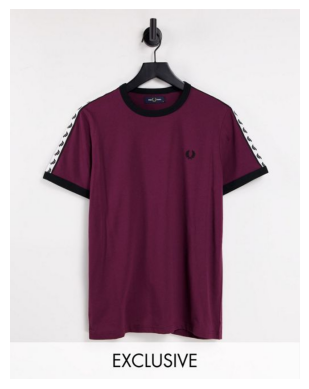

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Red, Probability: 0.36620816588401794
Color: Pink, Probability: 0.2818549573421478
Color: Yellow, Probability: 0.270764023065567
--------------------


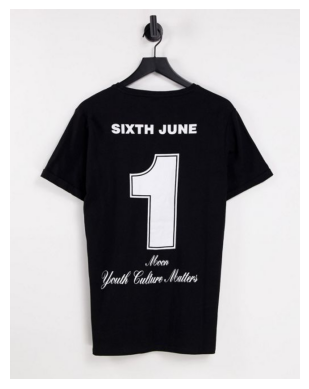

1/1 [==============================] - 0s 40ms/step
Predicted Color: Navy Blue
Color Probability: 0.9966709
--------------------


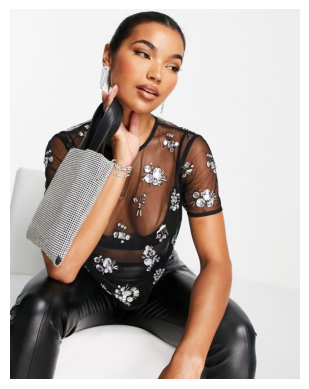

1/1 [==============================] - 0s 49ms/step
Predicted Color: Brown
Color Probability: 0.8113524
--------------------


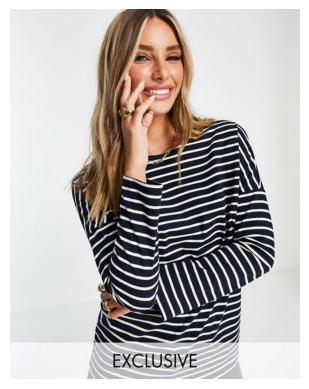

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.9999994
--------------------


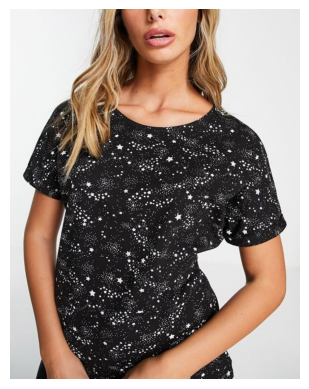

1/1 [==============================] - 0s 47ms/step
Predicted Color: Navy Blue
Color Probability: 0.8299951
--------------------


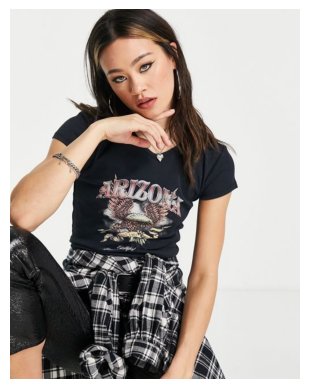

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.8965837
--------------------


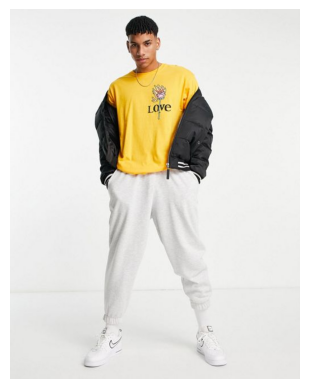

1/1 [==============================] - 0s 50ms/step
Predicted Color: Beige
Color Probability: 0.75364375
--------------------


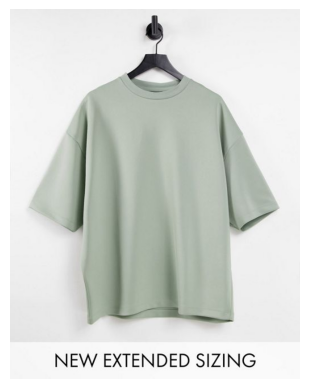

1/1 [==============================] - 0s 45ms/step
Top Three Colors:
Color: Beige, Probability: 0.4584748148918152
Color: Silver, Probability: 0.29865550994873047
Color: White, Probability: 0.10308784246444702
--------------------


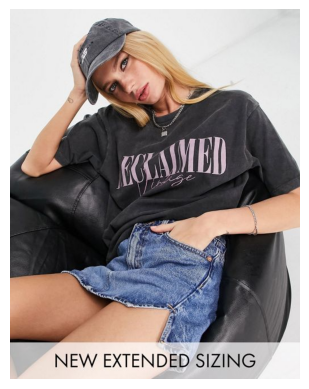

1/1 [==============================] - 0s 40ms/step
Predicted Color: Navy Blue
Color Probability: 0.7095743
--------------------


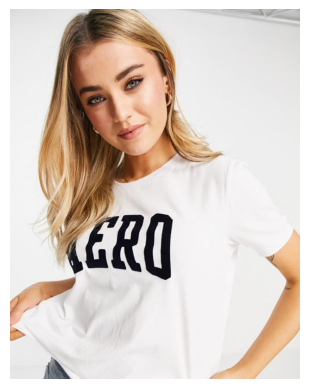

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: White, Probability: 0.5392377376556396
Color: Pink, Probability: 0.3932706117630005
Color: Olive, Probability: 0.03304929658770561
--------------------


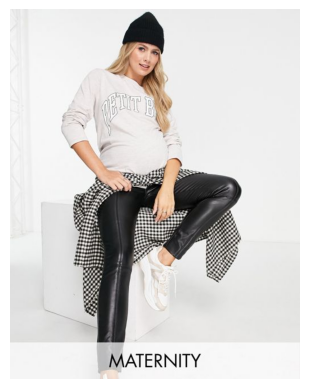

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Brown, Probability: 0.4348122775554657
Color: Black, Probability: 0.4110983908176422
Color: White, Probability: 0.15348446369171143
--------------------


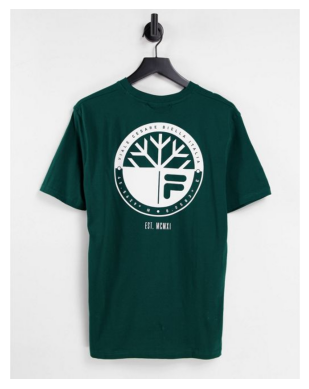

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.85359573
--------------------


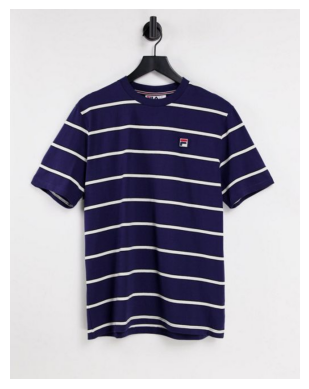

1/1 [==============================] - 0s 37ms/step
Predicted Color: Navy Blue
Color Probability: 0.97942483
--------------------


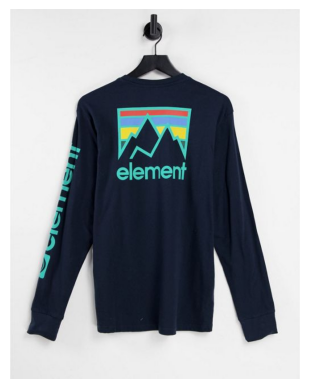

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Navy Blue, Probability: 0.4461577832698822
Color: Black, Probability: 0.296623557806015
Color: Blue, Probability: 0.2533654570579529
--------------------


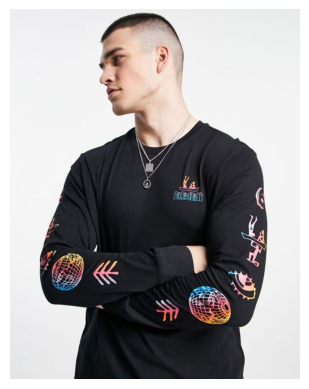

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.68228513
--------------------


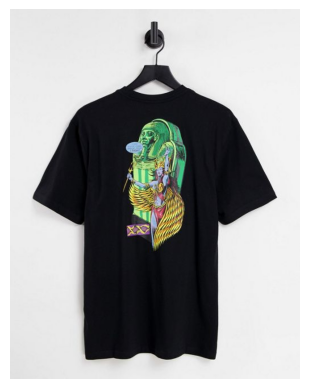

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.92498463
--------------------


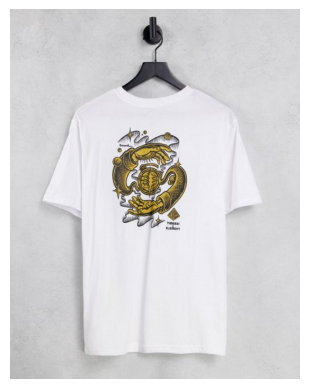

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.97553265
--------------------


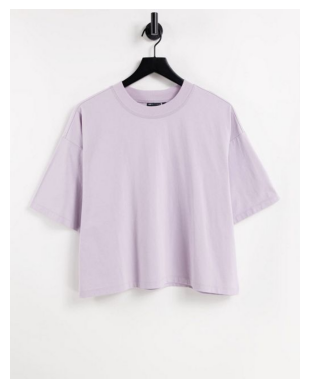

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.6605671
--------------------


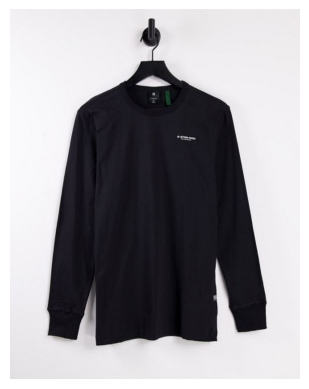

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.890109
--------------------


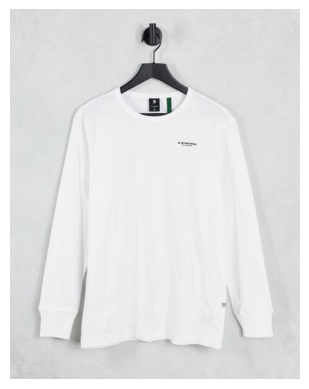

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.9884899
--------------------


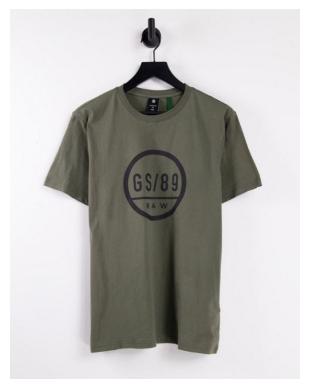

1/1 [==============================] - 0s 45ms/step
Predicted Color: Yellow
Color Probability: 0.74909836
--------------------


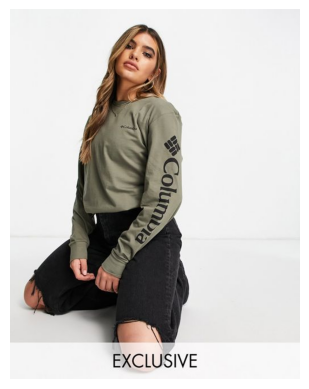

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.78735626
--------------------


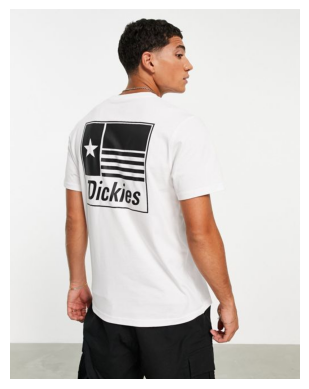

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.95027244
--------------------


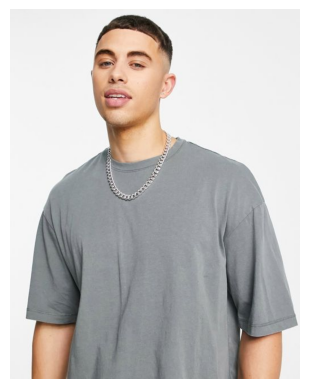

1/1 [==============================] - 0s 38ms/step
Predicted Color: Pink
Color Probability: 0.6857821
--------------------


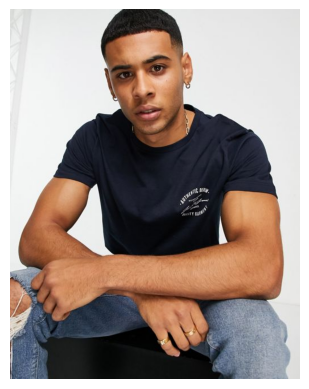

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.6384187
--------------------


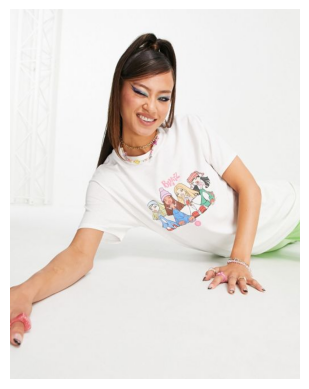

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.8249075
--------------------


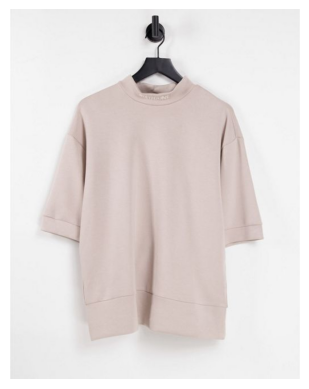

1/1 [==============================] - 0s 39ms/step
Predicted Color: Pink
Color Probability: 0.88425446
--------------------


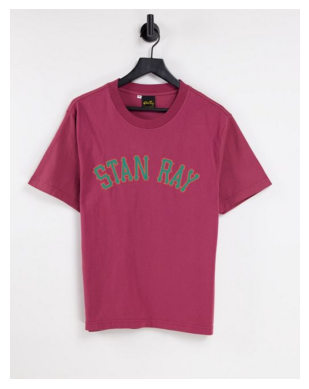

1/1 [==============================] - 0s 37ms/step
Predicted Color: Pink
Color Probability: 0.98749834
--------------------


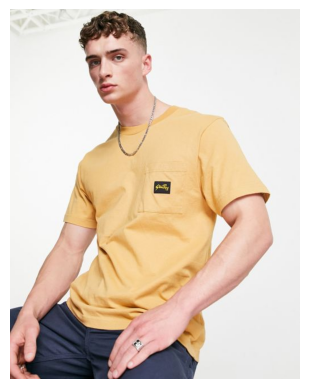

1/1 [==============================] - 0s 37ms/step
Predicted Color: Yellow
Color Probability: 0.99792296
--------------------


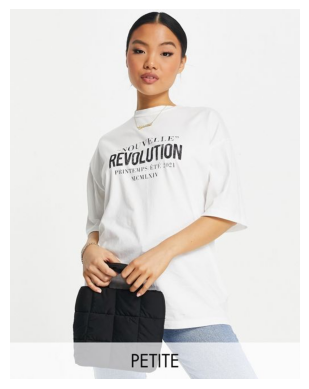

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Yellow, Probability: 0.5499211549758911
Color: Pink, Probability: 0.39960750937461853
Color: White, Probability: 0.030115783214569092
--------------------


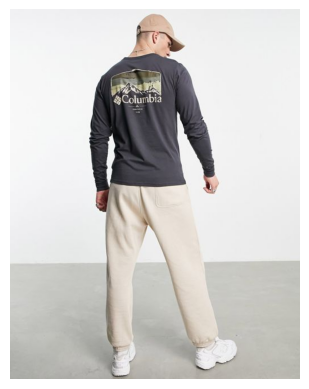

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.65594816
--------------------


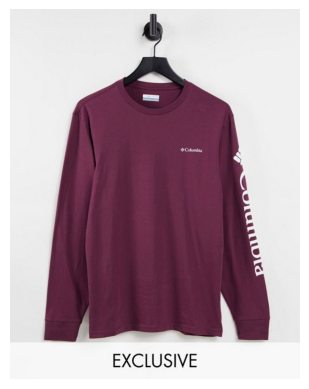

1/1 [==============================] - 0s 38ms/step
Predicted Color: Brown
Color Probability: 0.6483001
--------------------


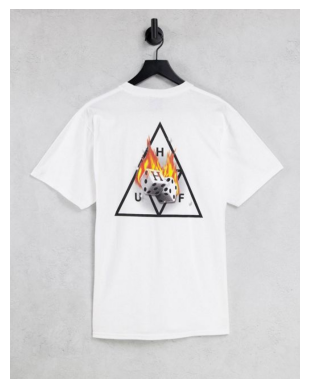

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.8340116
--------------------


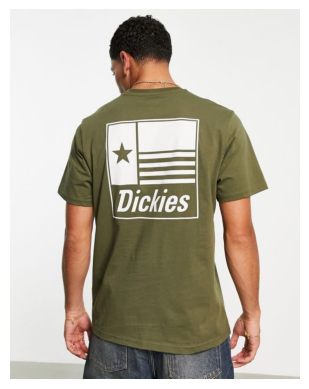

1/1 [==============================] - 0s 38ms/step
Predicted Color: Yellow
Color Probability: 0.9226474
--------------------


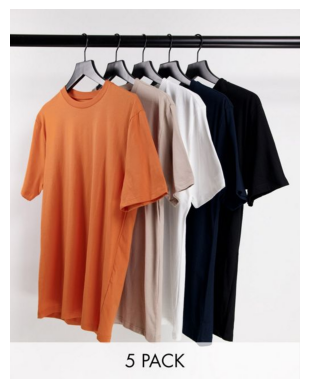

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.9300292
--------------------


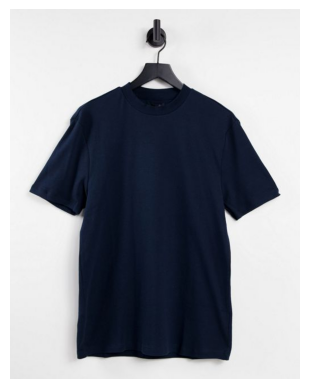

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.9428425
--------------------


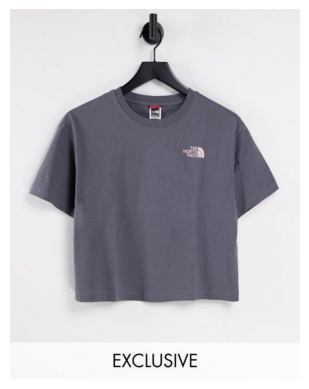

1/1 [==============================] - 0s 40ms/step
Top Three Colors:
Color: Blue, Probability: 0.5903996825218201
Color: White, Probability: 0.15898177027702332
Color: Black, Probability: 0.13271969556808472
--------------------


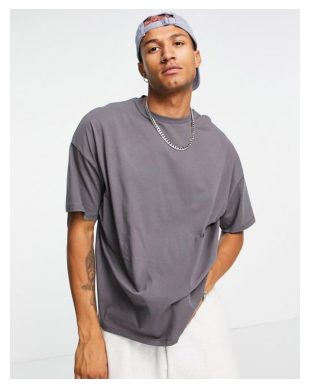

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.64727426
--------------------


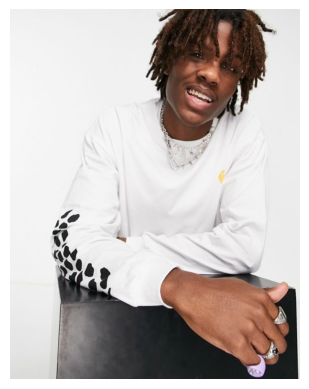

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.753357
--------------------


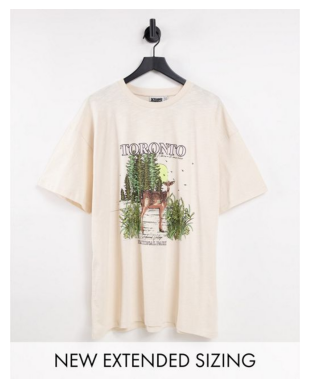

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.8764738
--------------------


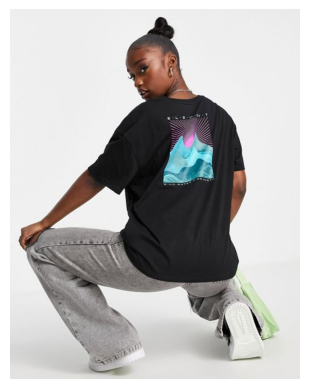

1/1 [==============================] - 0s 37ms/step
Predicted Color: Blue
Color Probability: 0.9884012
--------------------


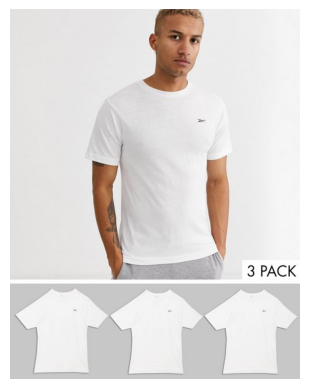

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Green, Probability: 0.29369983077049255
Color: Gold, Probability: 0.20586785674095154
Color: Pink, Probability: 0.15747053921222687
--------------------


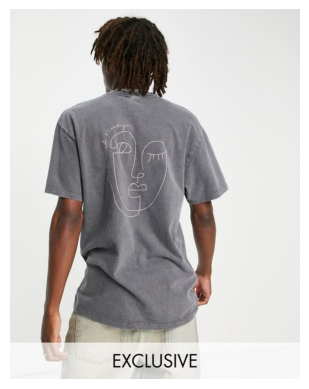

1/1 [==============================] - 0s 38ms/step
Predicted Color: Blue
Color Probability: 0.97065496
--------------------


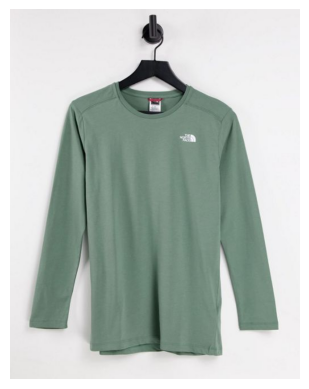

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Green, Probability: 0.4726066291332245
Color: Blue, Probability: 0.3887570798397064
Color: Beige, Probability: 0.07775141298770905
--------------------


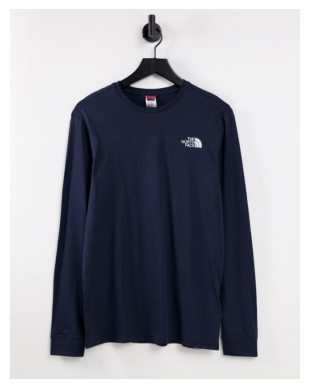

1/1 [==============================] - 0s 37ms/step
Predicted Color: Navy Blue
Color Probability: 0.8610964
--------------------


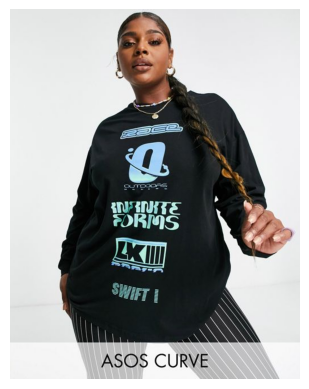

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.60609984
--------------------


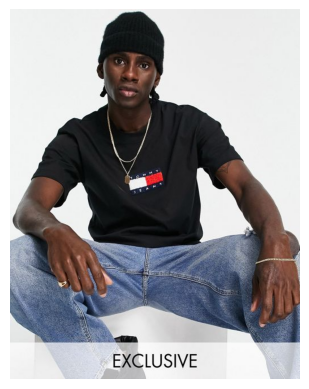

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.997686
--------------------


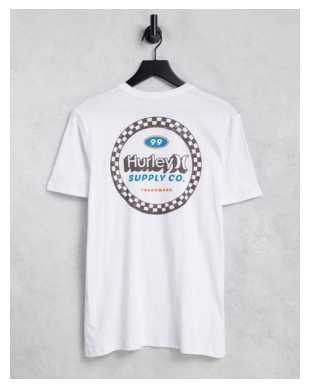

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9842031
--------------------


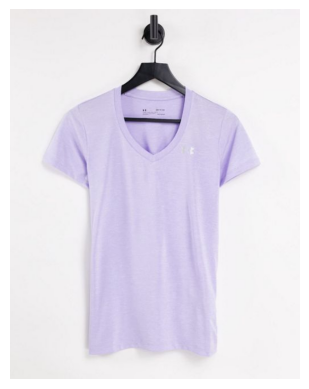

1/1 [==============================] - 0s 44ms/step
Predicted Color: White
Color Probability: 0.99334127
--------------------


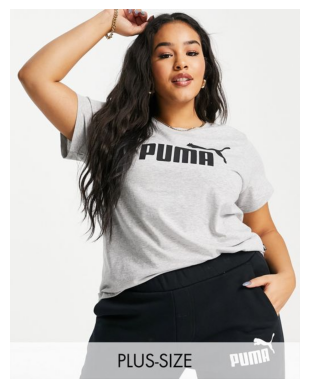

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9541238
--------------------


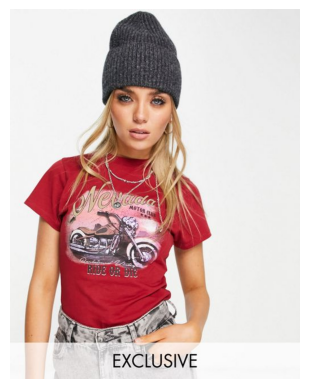

1/1 [==============================] - 0s 38ms/step
Predicted Color: Brown
Color Probability: 0.94987506
--------------------


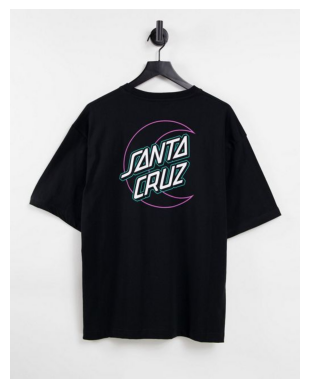

1/1 [==============================] - 0s 37ms/step
Predicted Color: Black
Color Probability: 0.8273793
--------------------


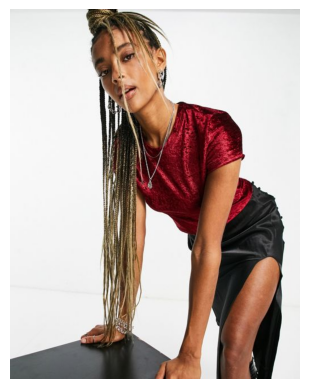

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: White, Probability: 0.508113443851471
Color: Black, Probability: 0.40883195400238037
Color: Yellow, Probability: 0.03399336710572243
--------------------


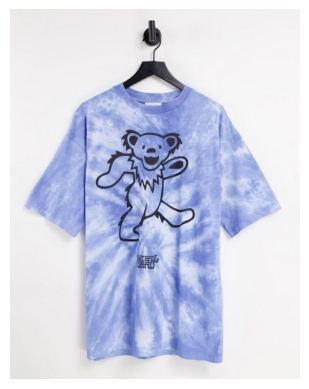

1/1 [==============================] - 0s 38ms/step
Predicted Color: Blue
Color Probability: 0.99994934
--------------------


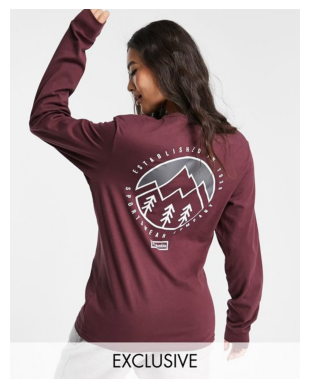

1/1 [==============================] - 0s 39ms/step
Predicted Color: Red
Color Probability: 0.9999865
--------------------


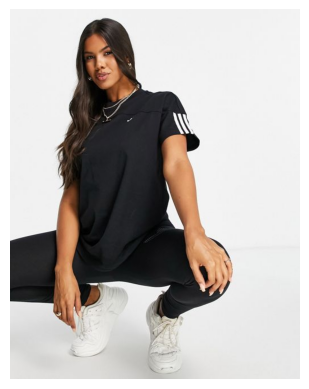

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Navy Blue, Probability: 0.4426364600658417
Color: Black, Probability: 0.4040599465370178
Color: White, Probability: 0.0990157425403595
--------------------


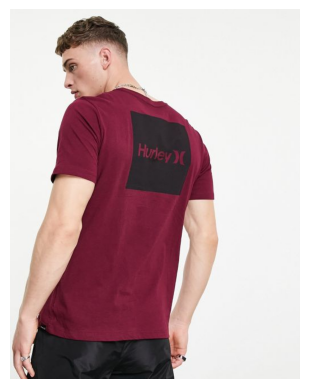

1/1 [==============================] - 0s 37ms/step
Predicted Color: Pink
Color Probability: 0.81630063
--------------------


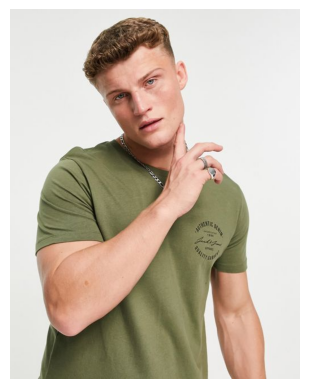

1/1 [==============================] - 0s 38ms/step
Predicted Color: Yellow
Color Probability: 0.8063374
--------------------


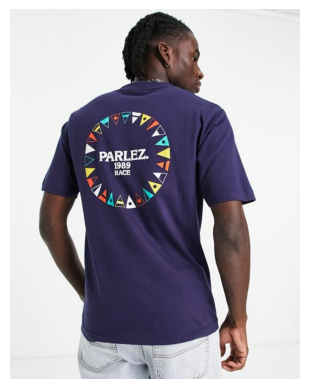

1/1 [==============================] - 0s 38ms/step
Predicted Color: Blue
Color Probability: 0.7738704
--------------------


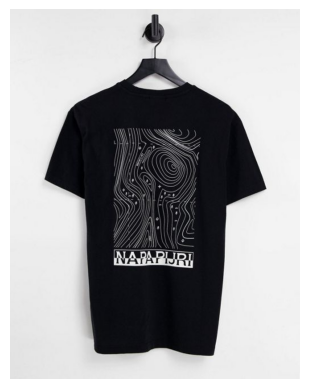

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.9999964
--------------------


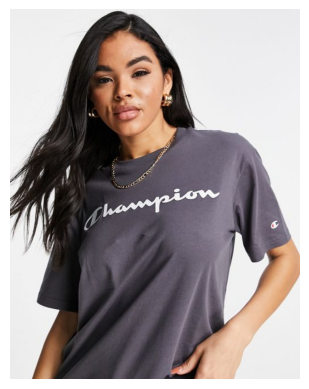

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.9002331
--------------------


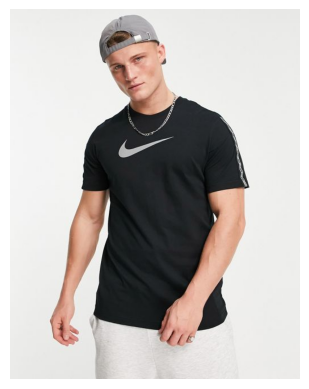

1/1 [==============================] - 0s 37ms/step
Predicted Color: Navy Blue
Color Probability: 0.84439105
--------------------


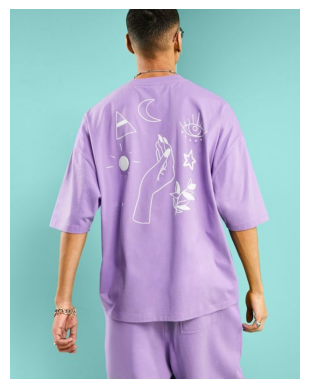

1/1 [==============================] - 0s 43ms/step
Predicted Color: Pink
Color Probability: 0.9952825
--------------------


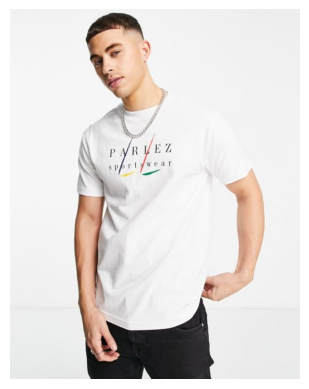

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9676375
--------------------


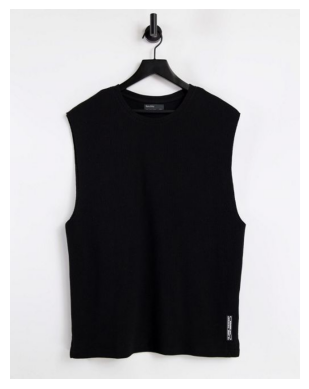

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.9999627
--------------------


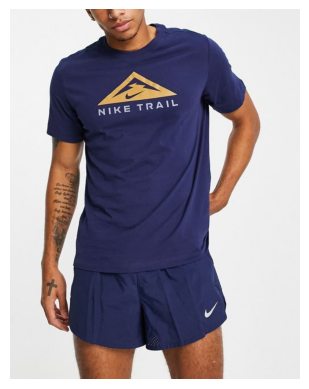

1/1 [==============================] - 0s 38ms/step
Predicted Color: Blue
Color Probability: 0.9613384
--------------------


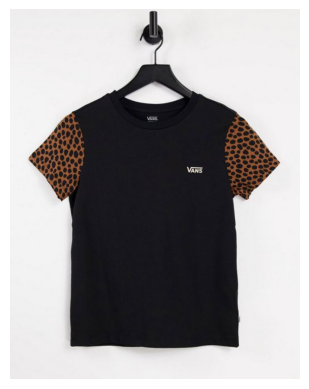

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.9999975
--------------------


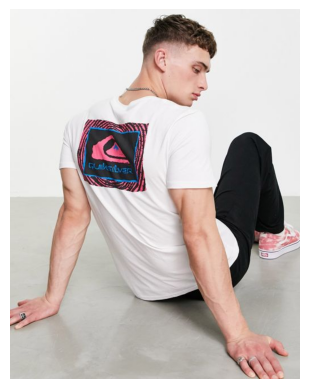

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: White, Probability: 0.5955572724342346
Color: Yellow, Probability: 0.30091503262519836
Color: Beige, Probability: 0.08012314885854721
--------------------


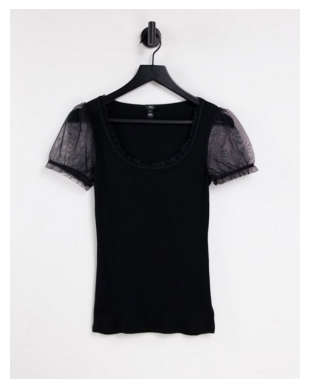

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.99986136
--------------------


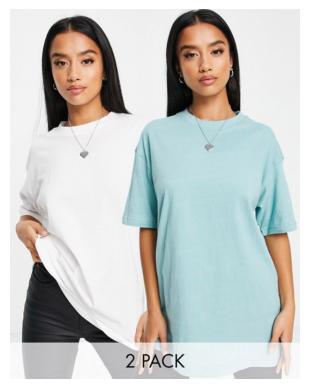

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.99928194
--------------------


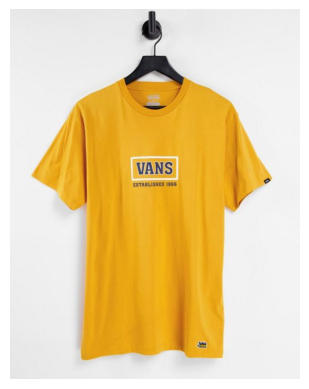

1/1 [==============================] - 0s 38ms/step
Predicted Color: Yellow
Color Probability: 0.99998534
--------------------


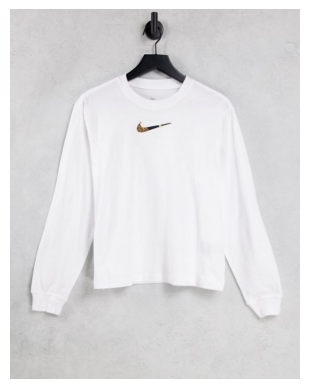

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9792779
--------------------


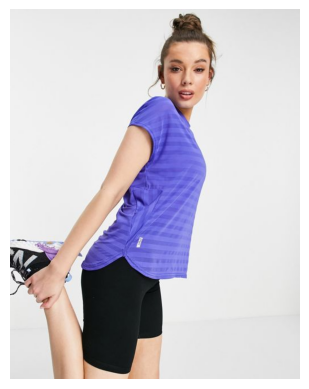

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Blue, Probability: 0.5666213631629944
Color: Pink, Probability: 0.3445560038089752
Color: White, Probability: 0.07672453671693802
--------------------


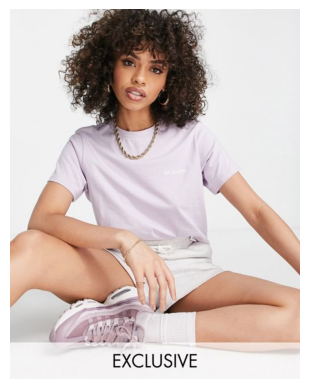

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9983407
--------------------


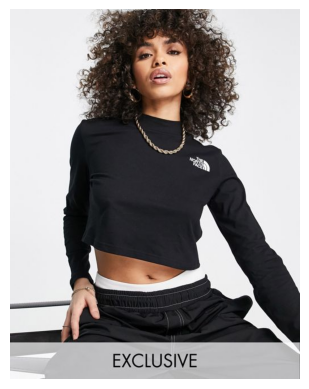

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.9412784
--------------------


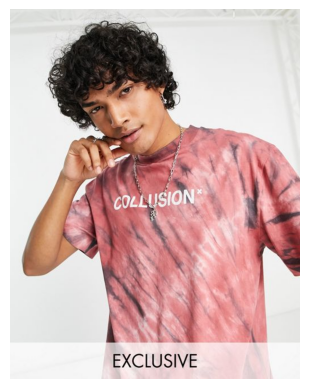

1/1 [==============================] - 0s 38ms/step
Predicted Color: Pink
Color Probability: 0.9672811
--------------------


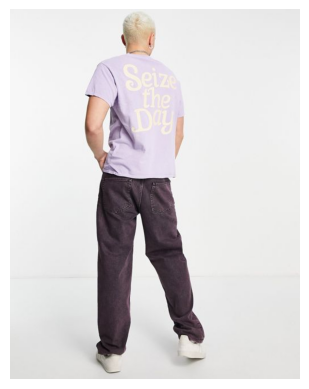

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: White, Probability: 0.51805579662323
Color: Olive, Probability: 0.3823398947715759
Color: Black, Probability: 0.05187573283910751
--------------------


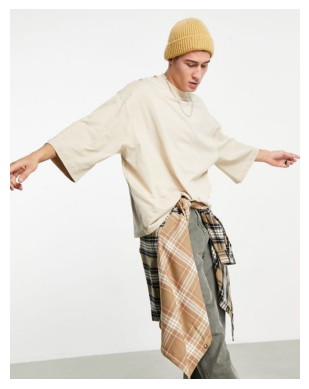

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9487712
--------------------


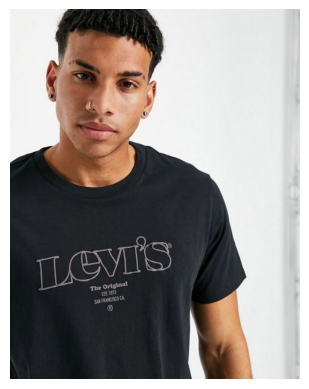

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.99837387
--------------------


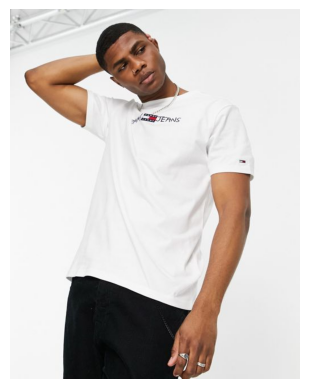

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9117478
--------------------


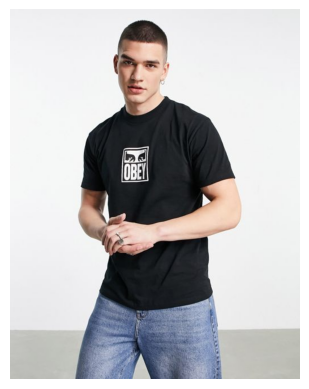

1/1 [==============================] - 0s 37ms/step
Predicted Color: Black
Color Probability: 0.99999905
--------------------


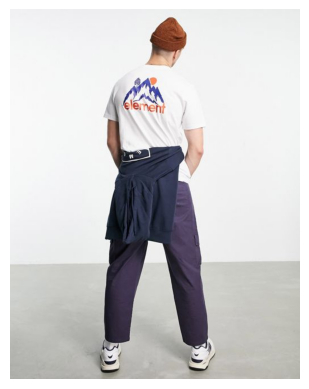

1/1 [==============================] - 0s 38ms/step
Predicted Color: Blue
Color Probability: 0.6561375
--------------------


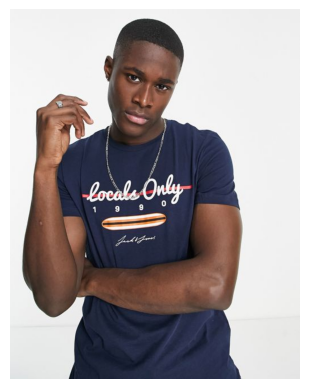

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.99947804
--------------------


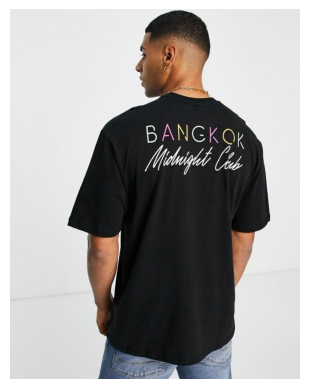

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.699933
--------------------


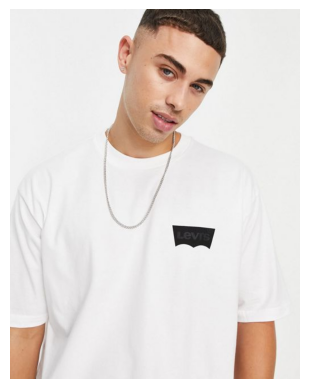

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.64276934
--------------------


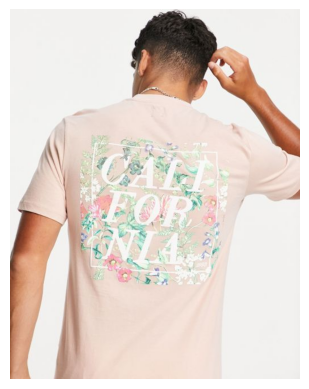

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9998274
--------------------


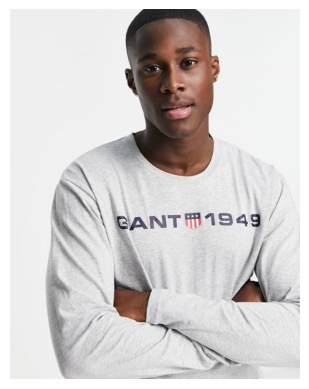

1/1 [==============================] - 0s 39ms/step
Top Three Colors:
Color: Beige, Probability: 0.49042025208473206
Color: Pink, Probability: 0.16906344890594482
Color: Red, Probability: 0.13409069180488586
--------------------


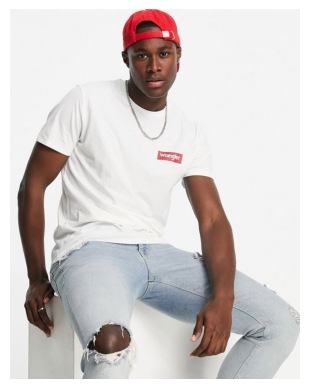

1/1 [==============================] - 0s 38ms/step
Predicted Color: Pink
Color Probability: 0.99582076
--------------------


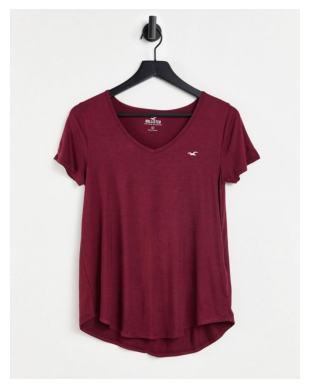

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Brown, Probability: 0.33746734261512756
Color: White, Probability: 0.3288821578025818
Color: Red, Probability: 0.12957663834095
--------------------


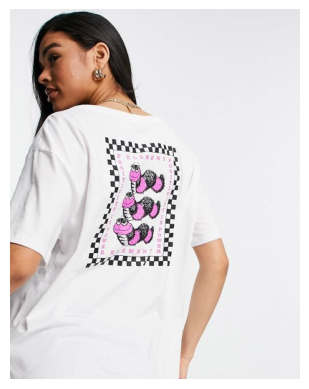

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.99992454
--------------------


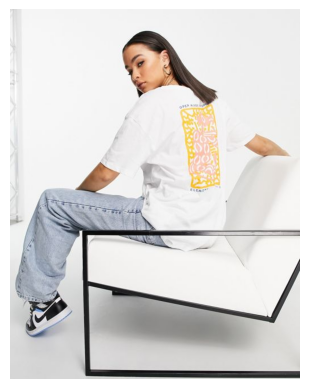

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.94666094
--------------------


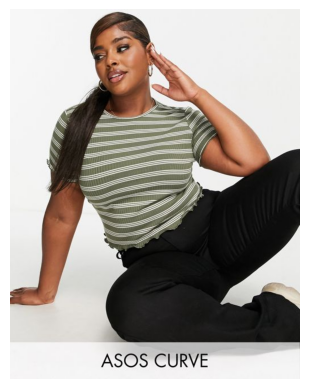

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.98068535
--------------------


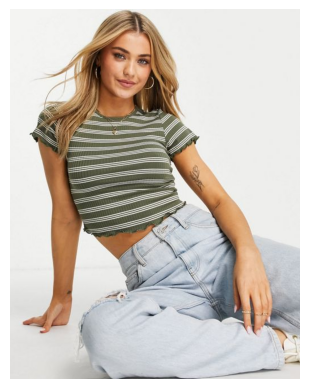

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Brown, Probability: 0.5853821039199829
Color: Black, Probability: 0.27816057205200195
Color: White, Probability: 0.08025997877120972
--------------------


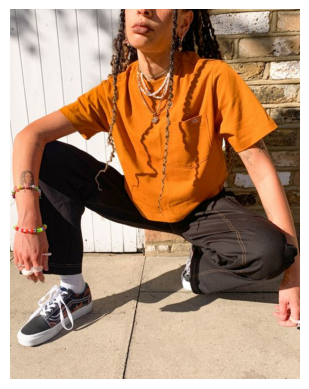

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.99664575
--------------------


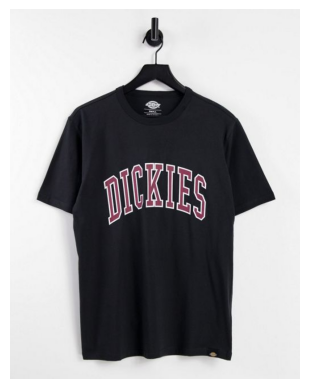

1/1 [==============================] - 0s 40ms/step
Predicted Color: Black
Color Probability: 0.9999981
--------------------


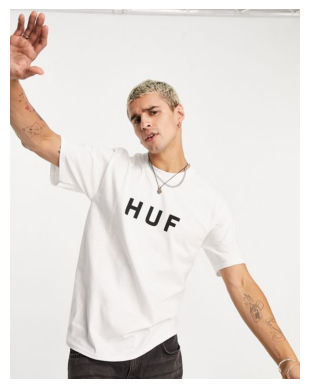

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.9997353
--------------------


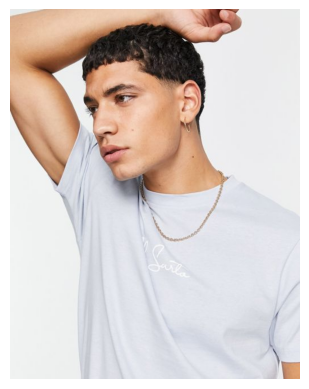

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.9975241
--------------------


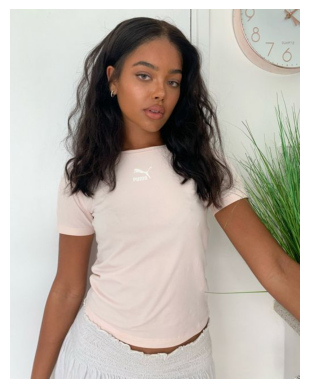

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: White, Probability: 0.585914671421051
Color: Beige, Probability: 0.22115255892276764
Color: Yellow, Probability: 0.05517302453517914
--------------------


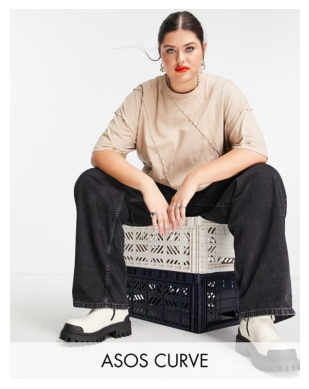

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.99468553
--------------------


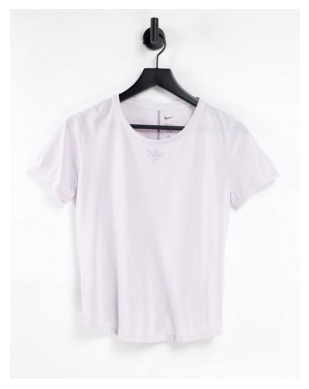

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.9902519
--------------------


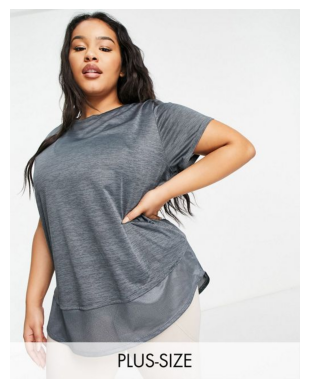

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.9708928
--------------------


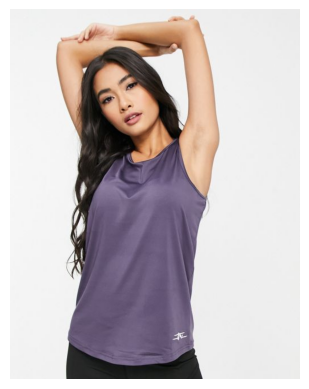

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.84979606
--------------------


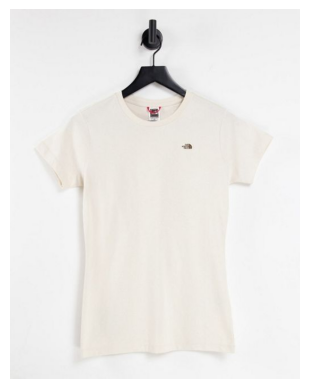

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.965542
--------------------


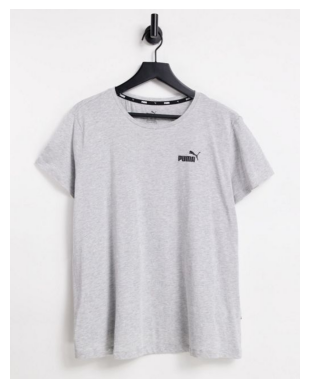

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.994911
--------------------


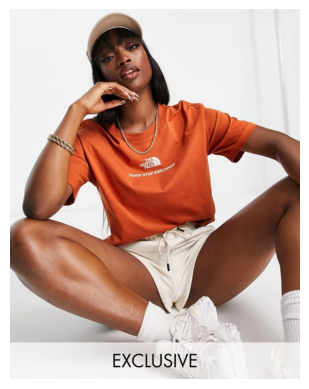

1/1 [==============================] - 0s 38ms/step
Predicted Color: Red
Color Probability: 0.9972736
--------------------


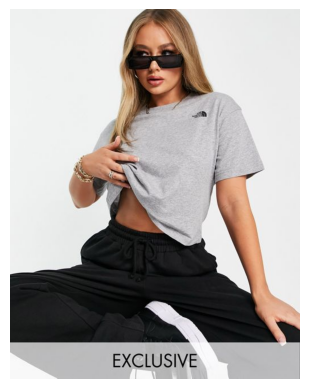

1/1 [==============================] - 0s 39ms/step
Predicted Color: White
Color Probability: 0.98989165
--------------------


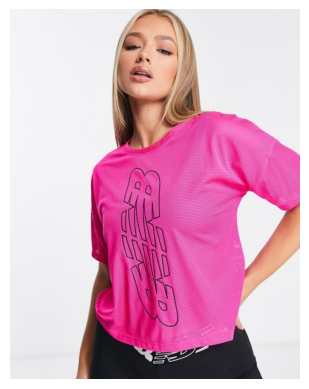

1/1 [==============================] - 0s 38ms/step
Predicted Color: Pink
Color Probability: 0.98857236
--------------------


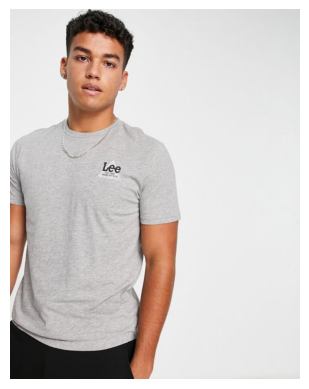

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.92300165
--------------------


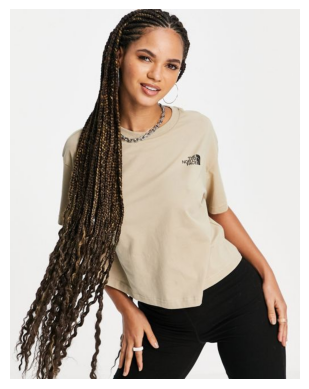

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Brown, Probability: 0.4854539930820465
Color: Yellow, Probability: 0.35157468914985657
Color: Pink, Probability: 0.09063590317964554
--------------------


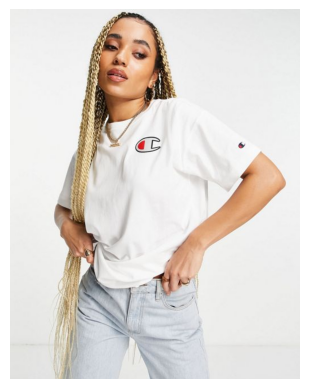

1/1 [==============================] - 0s 44ms/step
Predicted Color: Pink
Color Probability: 0.6529605
--------------------


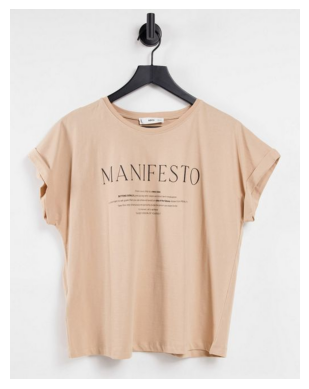

1/1 [==============================] - 0s 38ms/step
Predicted Color: Yellow
Color Probability: 0.9920021
--------------------


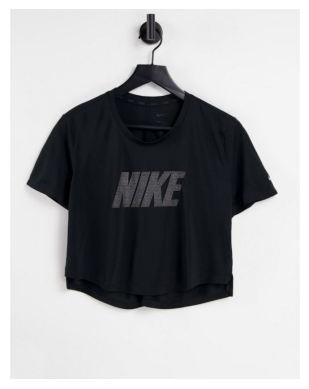

1/1 [==============================] - 0s 39ms/step
Predicted Color: Black
Color Probability: 0.99857235
--------------------


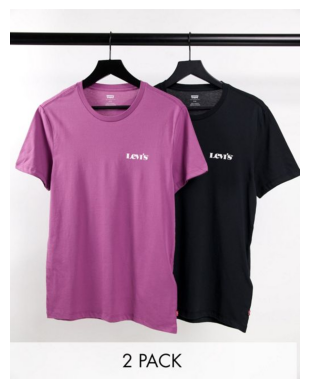

1/1 [==============================] - 0s 38ms/step
Predicted Color: Red
Color Probability: 0.633234
--------------------


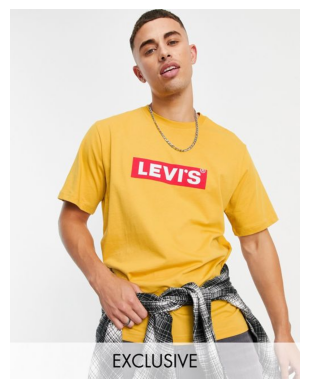

1/1 [==============================] - 0s 38ms/step
Predicted Color: Yellow
Color Probability: 0.999022
--------------------


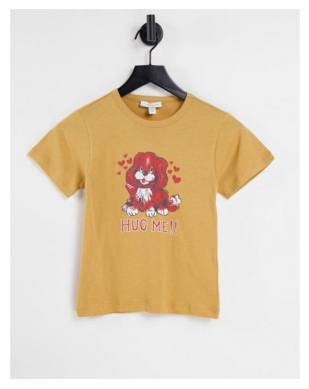

1/1 [==============================] - 0s 38ms/step
Predicted Color: Yellow
Color Probability: 0.9999732
--------------------


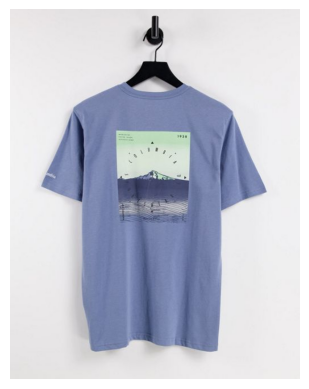

1/1 [==============================] - 0s 38ms/step
Predicted Color: Blue
Color Probability: 0.9999764
--------------------


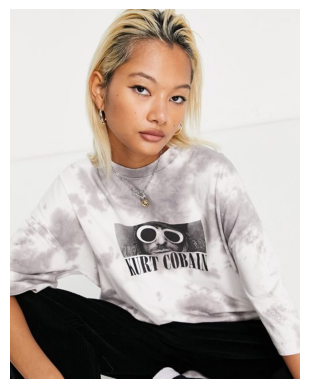

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.81823856
--------------------


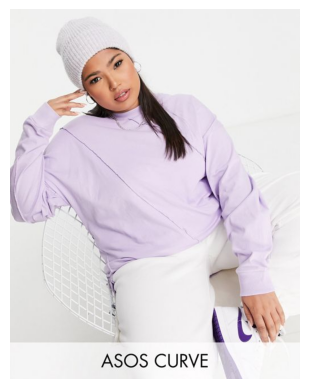

1/1 [==============================] - 0s 38ms/step
Predicted Color: White
Color Probability: 0.98136866
--------------------


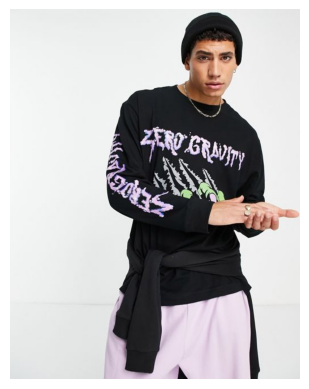

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.9951504
--------------------


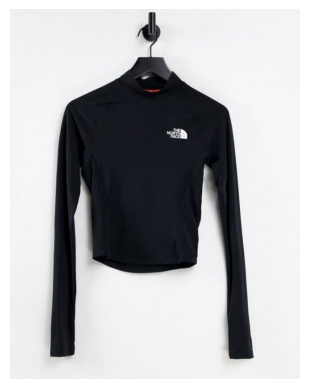

1/1 [==============================] - 0s 38ms/step
Predicted Color: Black
Color Probability: 0.99999976
--------------------


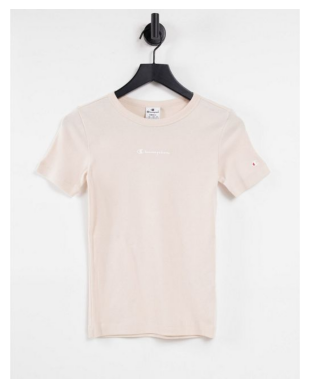

1/1 [==============================] - 0s 37ms/step
Predicted Color: White
Color Probability: 0.9114018
--------------------


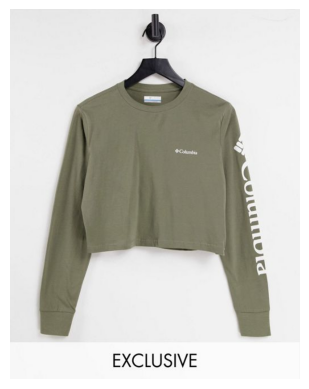

1/1 [==============================] - 0s 40ms/step
Predicted Color: Green
Color Probability: 0.6709871
--------------------


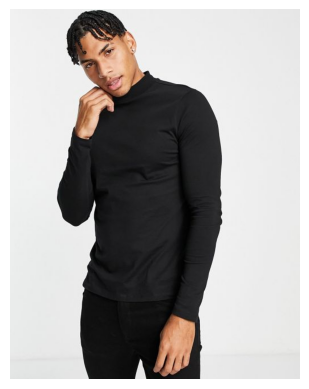

1/1 [==============================] - 0s 38ms/step
Predicted Color: Navy Blue
Color Probability: 0.9167481
--------------------


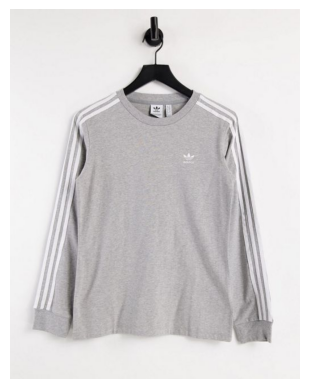

1/1 [==============================] - 0s 38ms/step
Top Three Colors:
Color: Blue, Probability: 0.45410823822021484
Color: Beige, Probability: 0.282413125038147
Color: White, Probability: 0.20032420754432678
--------------------


In [94]:
import matplotlib.pyplot as plt

image_paths = []
for i in range(1, 200):
    image_path = f"./tshirt/{i}.jpg"  # Replace with the actual image path format
    image_paths.append(image_path)

for image_path in image_paths:
    # Load and display the image
    image = load_img(image_path)
    plt.imshow(image)
    plt.axis('off')  # Hide the axis labels
    plt.show()

    # Process the image for prediction
    image = smart_resize(image, (image_width, image_height))
    image = img_to_array(image) / 255.0
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)
    predicted_color = label_encoder.inverse_transform(np.argmax(prediction, axis=1))
    softmax_probability = np.max(prediction)
    
    if softmax_probability < 0.6:
        # Get the top three colors and their corresponding probabilities
        top_three_indices = np.argsort(prediction[0])[::-1][:3]
        top_three_colors = label_encoder.inverse_transform(top_three_indices)
        top_three_probabilities = prediction[0][top_three_indices]

        # Print the top three colors and their probabilities
        print("Top Three Colors:")
        for color, probability in zip(top_three_colors, top_three_probabilities):
            print(f"Color: {color}, Probability: {probability}")
        print("--------------------")
    else:
        # Print the predicted color and its probability
        print("Predicted Color:", predicted_color[0])
        print("Color Probability:", softmax_probability)
        print("--------------------")


## Observations

1. Color model is not much accurate as gender prediction, as there are 39 different types of unique color and dataset is small (around 2700 images)
2. For more accurate prediction, png format images should be used as it doesn't include the background color.
3. Image must consist only 1 color to give best results